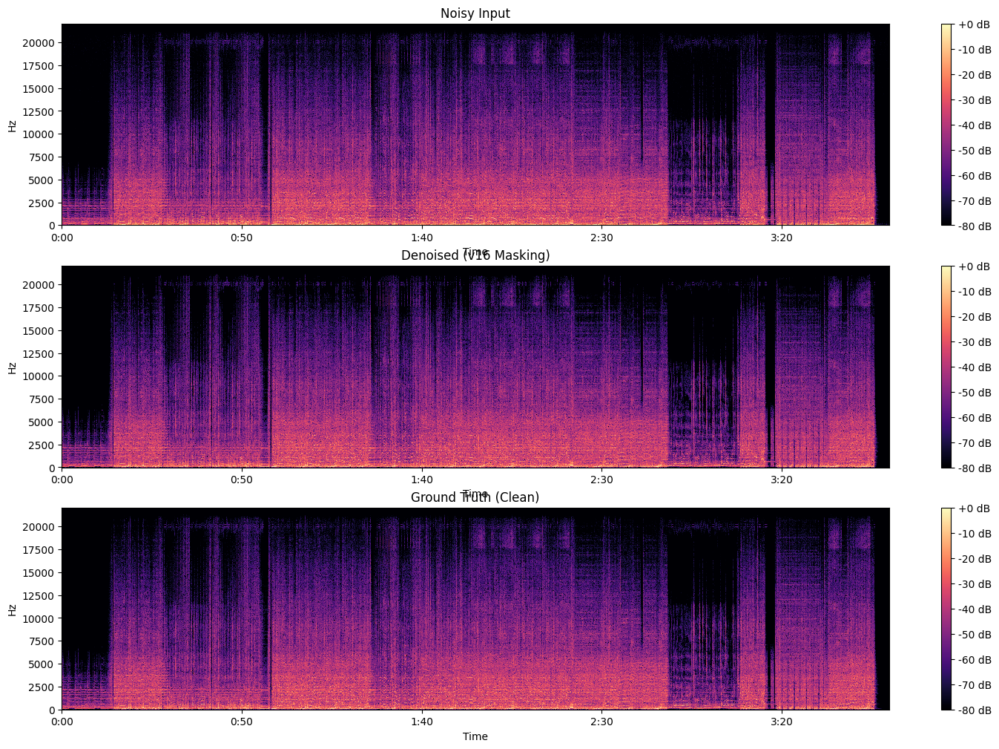

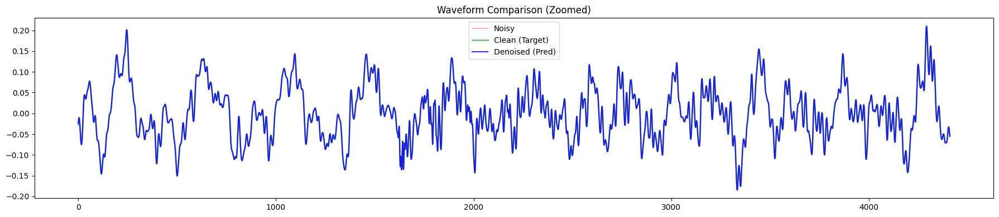

Predicted Audio:


In [3]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd

noisy_path = "data/Object Permanence_noisy.wav"
denoised_path = "data/OB_pred.wav"
clean_path = "data/Object Permanence_clean.wav"

def analyze_visual(noisy_p, denoised_p, clean_p):
    y_noise, sr = librosa.load(noisy_p, sr=44100)
    y_denoise, _ = librosa.load(denoised_p, sr=44100)
    y_clean, _ = librosa.load(clean_p, sr=44100)
    
    length = min(len(y_noise), len(y_denoise), len(y_clean))
    y_noise, y_denoise, y_clean = y_noise[:length], y_denoise[:length], y_clean[:length]
    
    def get_db_spec(y):
        return librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)

    S_noise = get_db_spec(y_noise)
    S_denoise = get_db_spec(y_denoise)
    S_clean = get_db_spec(y_clean)
    
    plt.figure(figsize=(18, 12))
    
    titles = ['Noisy Input', 'Denoised (v16 Masking)', 'Ground Truth (Clean)']
    specs = [S_noise, S_denoise, S_clean]
    
    for i, (spec, title) in enumerate(zip(specs, titles)):
        plt.subplot(3, 1, i+1)
        librosa.display.specshow(spec, sr=sr, x_axis='time', y_axis='hz', cmap='magma')
        plt.title(title)
        plt.colorbar(format='%+2.0f dB')

    plt.figure(figsize=(18, 4))
    start, end = int(1.0*sr), int(1.1*sr)
    plt.plot(y_noise[start:end], label='Noisy', alpha=0.3, color='red')
    plt.plot(y_clean[start:end], label='Clean (Target)', alpha=0.5, color='green', lw=2)
    plt.plot(y_denoise[start:end], label='Denoised (Pred)', alpha=0.8, color='blue')
    plt.title('Waveform Comparison (Zoomed)')
    plt.legend()
    plt.tight_layout()
    plt.show()

analyze_visual(noisy_path, denoised_path, clean_path)

print("Predicted Audio:")
ipd.display(ipd.Audio(denoised_path))

In [5]:
import numpy as np
import librosa
import torch
from torchmetrics.audio import ScaleInvariantSignalDistortionRatio as SI_SDR

def calculate_gt_metrics(noisy_p, denoised_p, clean_p):
    y_noise, sr = librosa.load(noisy_p, sr=44100)
    y_denoise, _ = librosa.load(denoised_p, sr=44100)
    y_clean, _ = librosa.load(clean_p, sr=44100)
    
    length = min(len(y_noise), len(y_denoise), len(y_clean))
    y_noise, y_denoise, y_clean = y_noise[:length], y_denoise[:length], y_clean[:length]

    stft_denoise = np.abs(librosa.stft(y_denoise))
    stft_clean = np.abs(librosa.stft(y_clean))
    
    lsd_val = np.mean(np.sqrt(np.mean((20 * np.log10(stft_clean + 1e-10) - 20 * np.log10(stft_denoise + 1e-10))**2, axis=0)))

    si_sdr_metric = SI_SDR()
    si_sdr = si_sdr_metric(torch.tensor(y_denoise), torch.tensor(y_clean)).item()

    frame_len = int(0.03 * sr)
    hop_len = frame_len // 2
    
    ssnr_values = []
    for i in range(0, length - frame_len, hop_len):
        clean_f = y_clean[i:i+frame_len]
        err_f = y_clean[i:i+frame_len] - y_denoise[i:i+frame_len]
        
        sig_pow = np.sum(clean_f**2)
        err_pow = np.sum(err_f**2) + 1e-10
        ssnr_values.append(10 * np.log10(sig_pow / err_pow))
    
    ssnr = np.mean(np.clip(ssnr_values, -10, 35))

    print(f"=== Анализ качества восстановления (vs Ground Truth) ===")
    print(f"Log-Spectral Distance (LSD):  {lsd_val:.4f} dB (diviation from perfection)")
    print(f"SI-SDR:                       {si_sdr:.2f} dB (structural similarity)")
    print(f"Segmental SNR (SSNR):        {ssnr:.2f} dB (signal cleanness)")
    
    # Оценка
    if si_sdr > 15:
        print("\nStatus: excellent.")
    elif si_sdr > 5:
        print("\nStatus: dood enoigh.")
    else:
        print("\nStatus: Significant signal distortion.")

calculate_gt_metrics(noisy_path, denoised_path, clean_path)

=== Анализ качества восстановления (vs Ground Truth) ===
Log-Spectral Distance (LSD):  6.4308 dB (diviation from perfection)
SI-SDR:                       18.77 dB (structural similarity)
Segmental SNR (SSNR):        19.62 dB (signal cleanness)

Status: excellent.
